In [16]:
import pathlib
import json
import numpy as np
import pandas as pd
import tifffile
import matplotlib.pyplot as plt

In [17]:
INTERNAL_DATASET = pathlib.Path('/kaggle/input/hubmap-organ-segmentation')

df_train = pd.read_csv(INTERNAL_DATASET / 'train.csv')
df_test = pd.read_csv(INTERNAL_DATASET / 'test.csv')

train_images = 'train_images/'
train_annotations = 'train_annotations/'
test_images = 'test_images/'

df_train['image_filename'] = df_train['id'].apply(lambda x:  str(INTERNAL_DATASET) + '/' + train_images + str(x) + '.tiff')
df_train['polygon_filename'] = df_train['id'].apply(lambda x:  str(INTERNAL_DATASET) + '/' + train_annotations + str(x) + '.json')
df_test['image_filename'] = df_test['id'].apply(lambda x:  str(INTERNAL_DATASET) + '/' + test_images + str(x) + '.tiff')
df_test['age'] = np.nan
df_test['sex'] = np.nan

print(f'Training Set Shape: {df_train.shape} - Memory Usage: {df_train.memory_usage().sum() / 1024 ** 2:.2f} MB')
print(f'Test Set Shape: {df_test.shape} - Memory Usage: {df_test.memory_usage().sum() / 1024 ** 2:.2f} MB')

Training Set Shape: (351, 12) - Memory Usage: 0.03 MB
Test Set Shape: (1, 10) - Memory Usage: 0.00 MB


In [18]:
def decode_rle_mask(rle_mask, shape):


    rle_mask = rle_mask.split()
    starts, lengths = [np.asarray(x, dtype=int) for x in (rle_mask[0:][::2], rle_mask[1:][::2])]
    starts -= 1
    ends = starts + lengths

    mask = np.zeros((shape[0] * shape[1]), dtype=np.uint8)
    for start, end in zip(starts, ends):
        mask[start:end] = 1

    mask = mask.reshape(shape[0], shape[1])
    return mask


def encode_rle_mask(mask):


    mask = mask.T.flatten()
    mask = np.concatenate([[0], mask, [0]])
    runs = np.where(mask[1:] != mask[:-1])[0] + 1
    runs[1::2] -= runs[::2]
    return ' '.join(str(x) for x in runs)


def get_segmentation_polygons_from_json(annotation_directory, image_id):

    with open(INTERNAL_DATASET / annotation_directory / f'{image_id}.json', mode='r') as f:
        polygons = json.load(f)

    return polygons

In [19]:
def visualize_annotations(image, rle_mask, polygons, metadata, path=None):


    if isinstance(image, pathlib.Path) or isinstance(image, str):
        # Read image from the given path
        image_path = image
        image = tifffile.imread(str(image_path))

    elif isinstance(image, np.ndarray):
        title = ''

    else:
        raise TypeError('Image is not an array or path.')

    if rle_mask is not None:
        mask = decode_rle_mask(rle_mask=rle_mask, shape=image.shape[:2])
        if metadata['data_source'] == 'HPA' or metadata['data_source'] == 'Hubmap':
            mask = mask.T

    if rle_mask is not None and polygons is not None:
        
        fig, axes = plt.subplots(figsize=(48, 20), ncols=3)

        axes[0].imshow(image)
        axes[1].imshow(image)

        if rle_mask is not None:
            axes[1].imshow(mask, alpha=0.5)
            axes[2].imshow(mask)

        if polygons is not None:
            for polygon in polygons:
                polygon = np.array(polygon)
                axes[1].plot(polygon[:, 0], polygon[:, 1], linewidth=2, color='red', alpha=0.5)
                axes[2].plot(polygon[:, 0], polygon[:, 1], linewidth=2, color='red')

        for i in range(3):
            axes[i].set_xlabel('')
            axes[i].set_ylabel('')
            axes[i].tick_params(axis='x', labelsize=15, pad=10)
            axes[i].tick_params(axis='y', labelsize=15, pad=10)

        axes[0].set_title('Image', size=25, pad=15)
        axes[1].set_title('Image + Ground Truth(Predicted)', size=25, pad=15)
        axes[2].set_title('Ground Truth (Mask)', size=25, pad=15)
    
    else:
        
        fig, ax = plt.subplots(figsize=(16, 20))
        ax.imshow(image)
        ax.set_xlabel('')
        ax.set_ylabel('')
        ax.tick_params(axis='x', labelsize=15, pad=10)
        ax.tick_params(axis='y', labelsize=15, pad=10)
        ax.set_title('Image', size=25, pad=15)

    fig.suptitle(
        f'''
        Image ID {metadata["id"]} - {metadata["organ"]} - {metadata["data_source"]} - {metadata["age"]} - {metadata["sex"]}
        Image Shape: {metadata["img_height"]}x{metadata["img_width"]} - Pixel Size: {metadata["pixel_size"]}µm - Tissue Thickness: {metadata["tissue_thickness"]}µm
        ''',
        fontsize=50
    )

    if path is None:
        plt.show()
    else:
        plt.savefig(path)
        plt.close(fig)

Image ID 10044


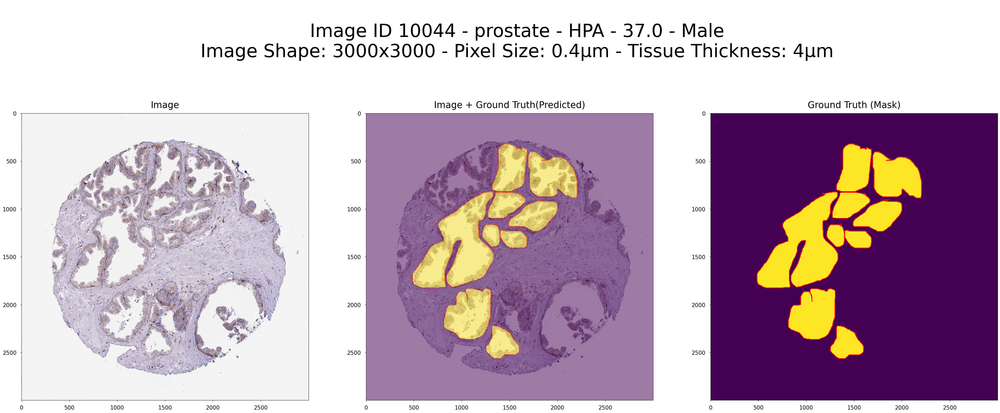

Image ID 10274


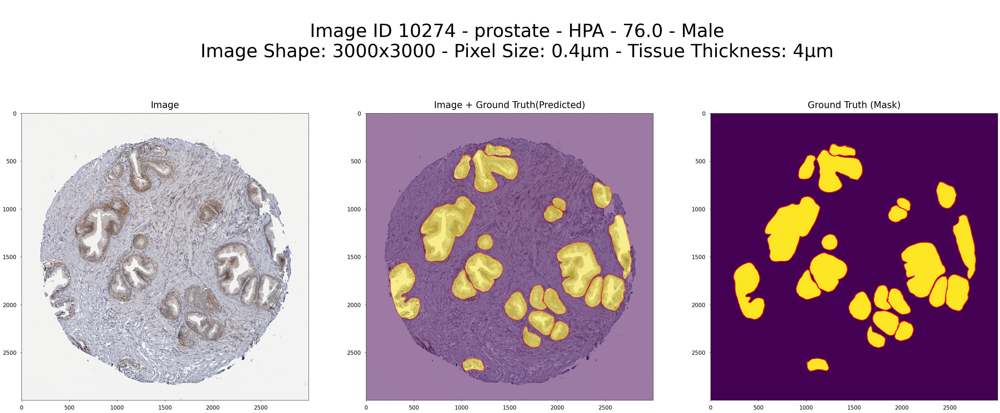

Image ID 10392


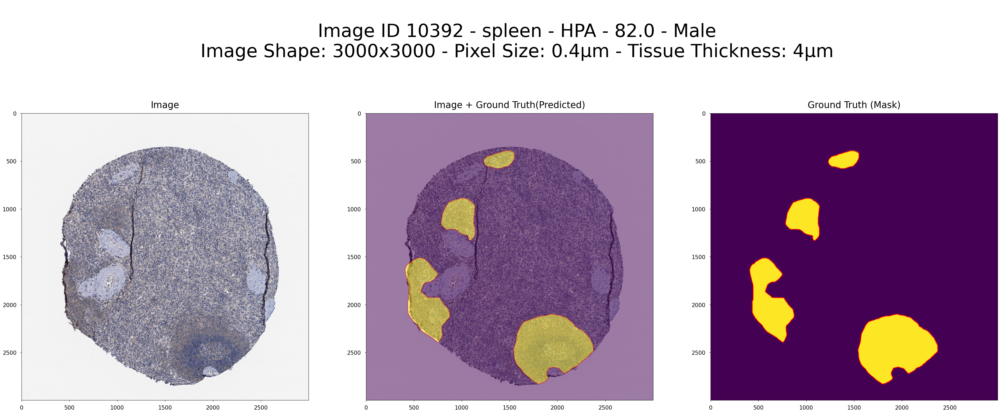

Image ID 10488


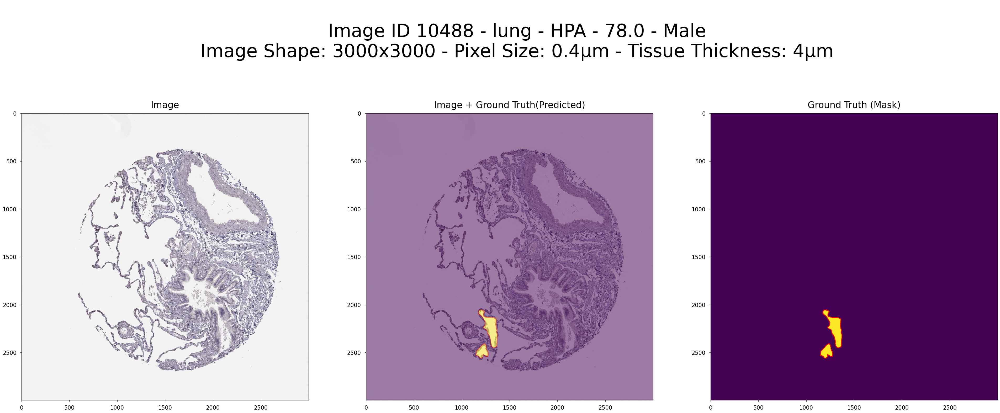

Image ID 10610


In [ ]:
for idx, row in df_train.iterrows():
    
    image = tifffile.imread(row['image_filename'])
    rle_mask = row['rle']
    polygons = get_segmentation_polygons_from_json(annotation_directory='train_annotations', image_id=row['id'])
    
    print(f'Image ID {row["id"]}')
    
    visualize_annotations(
        image=image,
        rle_mask=rle_mask,
        polygons=polygons,
        metadata=row.to_dict(),
        path=None
    )

In [ ]:
for idx, row in df_test.iterrows():
    
    image = tifffile.imread(row['image_filename'])
    rle_mask = None
    polygons = None
    
    print(f'Image ID {row["id"]}')
    
    visualize_annotations(
        image=image,
        rle_mask=rle_mask,
        polygons=polygons,
        metadata=row.to_dict(),
        path=None
    )